<a href="https://colab.research.google.com/github/mmurker/-Unsupervised-Representation-Learning-With-Deep-Convolutional-Generative-Adversarial-Networks/blob/main/MyApp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install -q keras 
import keras

path = "/content/drive/MyDrive/Colab Notebooks/DeepFakeTools/Deepfake-detection/data/Real2"

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense 
from tensorflow.keras.layers import Flatten, BatchNormalization
from tensorflow.keras.layers import Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam
import numpy as np
from PIL import Image
from tqdm import tqdm
import os 
import time
import matplotlib.pyplot as plt

In [ ]:
GENERATE_RES = 3 # Nesil Faktörü 
# (1=32, 2=64, 3=96, 4=128, ....)
GENERATE_SQUARE = 32 * GENERATE_RES # satırlar/sütunlar (kare matris olmak zorunda)
IMAGE_CHANNELS = 3 # Red Green Blue 

# Görüntü önizleme, çıktı katmanında 7x4 boyutunda resimler meydana gelecek 
PREVIEW_ROWS = 4
PREVIEW_COLS = 7
PREVIEW_MARGIN = 16

# Görüntülerin oluşturulacağı vektör boyutu
SEED_SIZE = 100

# Genel Yapı
DATA_PATH = path # Dataseti
EPOCHS = 50 #Tekrar Sayısı
BATCH_SIZE = 32 #batch built-in fonksiyonunda kullnılacak olan boyut parametresi, arraylar birleştirilecek
BUFFER_SIZE = 60000 #shuffle built-in fonksiyonunda kullanılacak karıştırma parametresi


print(f"Will generate {GENERATE_SQUARE}px square images.")
print(len(DATA_PATH),type(DATA_PATH))

Will generate 96px square images.
82 <class 'str'>


In [ ]:
def hms_string(sec_elapsed):
    h = int(sec_elapsed / (60 * 60))
    m = int((sec_elapsed % (60 * 60)) / 60)
    s = sec_elapsed % 60
    return "{}:{:>02}:{:>05.2f}".format(h, m, s)

In [ ]:
training_binary_path = os.path.join(DATA_PATH,
        f'training_data_{GENERATE_SQUARE}_{GENERATE_SQUARE}.npy')

print(f"Looking for file: {training_binary_path}")

if not os.path.isfile(training_binary_path):
  start = time.time()
  print("Loading training images...")

  training_data = []
  faces_path = os.path.join(DATA_PATH)
  for filename in tqdm(os.listdir(faces_path)):
      path = os.path.join(faces_path,filename)
      image = Image.open(path).resize((GENERATE_SQUARE,
            GENERATE_SQUARE),Image.ANTIALIAS)
      training_data.append(np.asarray(image))
  training_data = np.reshape(training_data,(-1,GENERATE_SQUARE,
            GENERATE_SQUARE,IMAGE_CHANNELS))
  training_data = training_data.astype(np.float32)
  training_data = training_data / 127.5 - 1. #[-1 ile 1 arasında normalize işlemi]


  print("Saving training image binary...")
  np.save(training_binary_path,training_data)
  elapsed = time.time()-start
  print (f'Image preprocess time: {hms_string(elapsed)}')
else:
  print("Loading previous training pickle...")
  training_data = np.load(training_binary_path)

Looking for file: /content/drive/MyDrive/Colab Notebooks/DeepFakeTools/Deepfake-detection/data/Real2/training_data_96_96.npy
Loading training images...


100%|██████████| 490/490 [00:02<00:00, 218.26it/s]


Saving training image binary...
Image preprocess time: 0:00:02.75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<class 'numpy.ndarray'> 96


array([[[  0.,   0.,  -0.],
        [  0.,   0., 255.],
        [  0.,   0.,   0.],
        ...,
        [  1.,   1., 255.],
        [  1.,   1.,   1.],
        [  1.,   1., 255.]],

       [[  0.,   0., 255.],
        [  0.,   0.,   0.],
        [  0.,   0., 255.],
        ...,
        [  1.,   1.,   1.],
        [  1.,   1., 255.],
        [  1.,   1.,   1.]],

       [[  0.,   0.,   0.],
        [  0.,   0., 255.],
        [  0.,   0.,   0.],
        ...,
        [  1.,   1., 255.],
        [  1.,   1.,   1.],
        [  1.,   1., 255.]],

       ...,

       [[ -1.,  -1., 255.],
        [ -1.,  -1.,  -1.],
        [ -1.,  -1., 255.],
        ...,
        [ -1.,  -1.,  -1.],
        [ -1.,  -1., 255.],
        [ -1.,  -1.,  -1.]],

       [[ -1.,  -1.,  -1.],
        [ -1.,  -1., 255.],
        [ -1.,  -1.,  -1.],
        ...,
        [ -1.,  -1., 255.],
        [ -1.,  -1.,  -1.],
        [ -1.,  -1., 255.]],

       [[ -1.,  -1., 255.],
        [ -1.,  -1.,  -1.],
        [ -1.,  

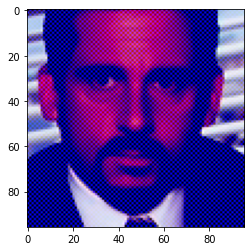

In [ ]:
X = np.load("/content/drive/MyDrive/Colab Notebooks/DeepFakeTools/Deepfake-detection/data/Real2/training_data_96_96.npy")
image1 = X[15]
for i in range(96):
  for j in range(96):
    if(i+j)%2==1:
      image1[i,j,2]=255

plt.imshow(image1)
print(type(image1),len(image1))
np.ndarray.round(image1,0)

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices(training_data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
def build_generator(seed_size, channels):
    model = Sequential()

    model.add(Dense(4*4*256,activation="relu",input_dim=seed_size))
    model.add(Reshape((4,4,256)))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    model.add(UpSampling2D())
    model.add(Conv2D(256,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))
   
    # Output resolution, additional upsampling
    model.add(UpSampling2D())
    model.add(Conv2D(128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(Activation("relu"))

    if GENERATE_RES>1:
      model.add(UpSampling2D(size=(GENERATE_RES,GENERATE_RES)))
      model.add(Conv2D(128,kernel_size=3,padding="same"))
      model.add(BatchNormalization(momentum=0.8))
      model.add(Activation("relu"))

    # Final CNN layer
    model.add(Conv2D(channels,kernel_size=3,padding="same"))
    model.add(Activation("tanh"))

    return model


def build_discriminator(image_shape):
    model = Sequential()

    model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=image_shape, 
                     padding="same"))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
    model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model

In [ ]:
def save_images(cnt,noise):
  image_array = np.full(( 
      PREVIEW_MARGIN + (PREVIEW_ROWS * (GENERATE_SQUARE+PREVIEW_MARGIN)), 
      PREVIEW_MARGIN + (PREVIEW_COLS * (GENERATE_SQUARE+PREVIEW_MARGIN)), 3), 
      255, dtype=np.uint8)
  
  generated_images = generator.predict(noise)

  generated_images = 0.5 * generated_images + 0.5

  image_count = 0
  for row in range(PREVIEW_ROWS):
      for col in range(PREVIEW_COLS):
        r = row * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        c = col * (GENERATE_SQUARE+16) + PREVIEW_MARGIN
        image_array[r:r+GENERATE_SQUARE,c:c+GENERATE_SQUARE] = generated_images[image_count] * 255
        image_count += 1

          
  output_path = os.path.join(DATA_PATH,'output')
  if not os.path.exists(output_path):
    os.makedirs(output_path)
  
  filename = os.path.join(output_path,f"train-{cnt}.png")
  im = Image.fromarray(image_array)
  im.save(filename)

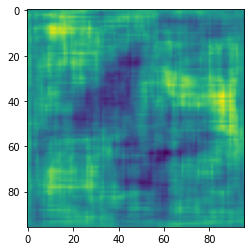

In [ ]:
generator = build_generator(SEED_SIZE, IMAGE_CHANNELS)

noise = tf.random.normal([1, SEED_SIZE])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0])

In [ ]:
image_shape = (GENERATE_SQUARE,GENERATE_SQUARE,IMAGE_CHANNELS)

discriminator = build_discriminator(image_shape)
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.49972102]], shape=(1, 1), dtype=float32)


In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)

In [ ]:
@tf.function
def train_step(images):
  seed = tf.random.normal([BATCH_SIZE, SEED_SIZE])

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(seed, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)
    

    gradients_of_generator = gen_tape.gradient(
        gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(
        disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(
        gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(
        gradients_of_discriminator, 
        discriminator.trainable_variables))
  return gen_loss,disc_loss

In [ ]:
def train(dataset, epochs):
  fixed_seed = np.random.normal(0, 1, (PREVIEW_ROWS * PREVIEW_COLS, 
                                       SEED_SIZE))
  start = time.time()

  for epoch in range(epochs):
    epoch_start = time.time()

    gen_loss_list = []
    disc_loss_list = []

    for image_batch in dataset:
      t = train_step(image_batch)
      gen_loss_list.append(t[0])
      disc_loss_list.append(t[1])

    g_loss = sum(gen_loss_list) / len(gen_loss_list)
    d_loss = sum(disc_loss_list) / len(disc_loss_list)

    epoch_elapsed = time.time()-epoch_start
    print (f'Epoch {epoch+1}, gen loss={g_loss},disc loss={d_loss},'
           ' {hms_string(epoch_elapsed)}')
    save_images(epoch,fixed_seed)

  elapsed = time.time()-start
  print (f'Training time: {hms_string(elapsed)}')

In [ ]:
train(train_dataset, EPOCHS)

Epoch 1, gen loss=1.7913249731063843,disc loss=0.7969334721565247, {hms_string(epoch_elapsed)}
Epoch 2, gen loss=2.639806032180786,disc loss=0.5276483297348022, {hms_string(epoch_elapsed)}
Epoch 3, gen loss=3.0682923793792725,disc loss=0.5465590357780457, {hms_string(epoch_elapsed)}
Epoch 4, gen loss=2.840125560760498,disc loss=0.5931566953659058, {hms_string(epoch_elapsed)}
Epoch 5, gen loss=3.5682427883148193,disc loss=0.34553810954093933, {hms_string(epoch_elapsed)}
Epoch 6, gen loss=3.665719747543335,disc loss=0.43291765451431274, {hms_string(epoch_elapsed)}
Epoch 7, gen loss=4.868480205535889,disc loss=1.032827615737915, {hms_string(epoch_elapsed)}
Epoch 8, gen loss=4.8866777420043945,disc loss=0.9169303178787231, {hms_string(epoch_elapsed)}
Epoch 9, gen loss=3.434210777282715,disc loss=1.2439213991165161, {hms_string(epoch_elapsed)}
Epoch 10, gen loss=3.1957569122314453,disc loss=0.6506403088569641, {hms_string(epoch_elapsed)}
Epoch 11, gen loss=3.695096254348755,disc loss=1.1118

In [ ]:
generator.save(os.path.join(DATA_PATH,"my_gan_app.h5"))

In [ ]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

In [ ]:
def display_image(epoch_no):
  return PIL.Image.open('/content/drive/MyDrive/Colab Notebooks/DeepFakeTools/Deepfake-detection/data/Real2/output/train-{}.png'.format(epoch_no))

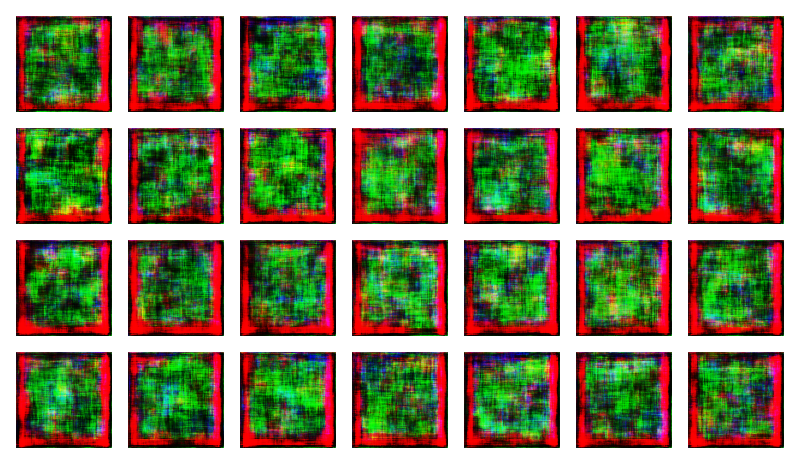

In [ ]:
display_image(1)

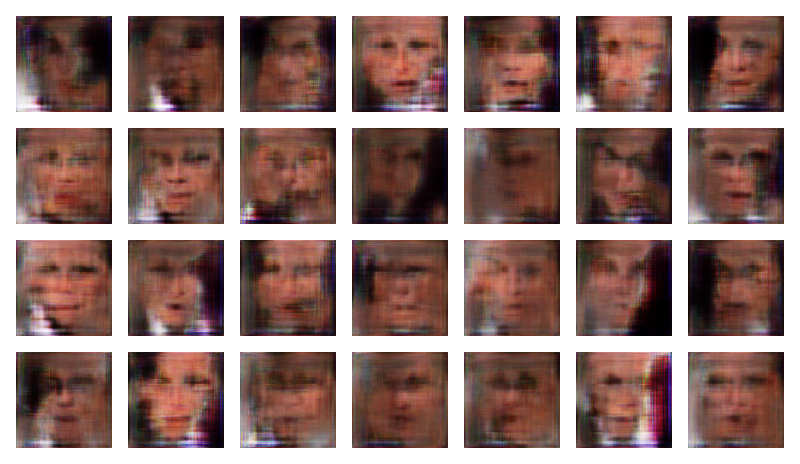

In [ ]:
display_image(49)

In [ ]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('/content/drive/MyDrive/Colab Notebooks/DeepFakeTools/Deepfake-detection/data/Real2/output/train*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [ ]:
pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-9mwi0b99
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-9mwi0b99
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=159918 sha256=49a38ccb683304cd2c284dc5f784a545fea46c86e17144f62e5e3ed9e31317d3
  Stored in directory: /tmp/pip-ephem-wheel-cache-vcda2a56/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs



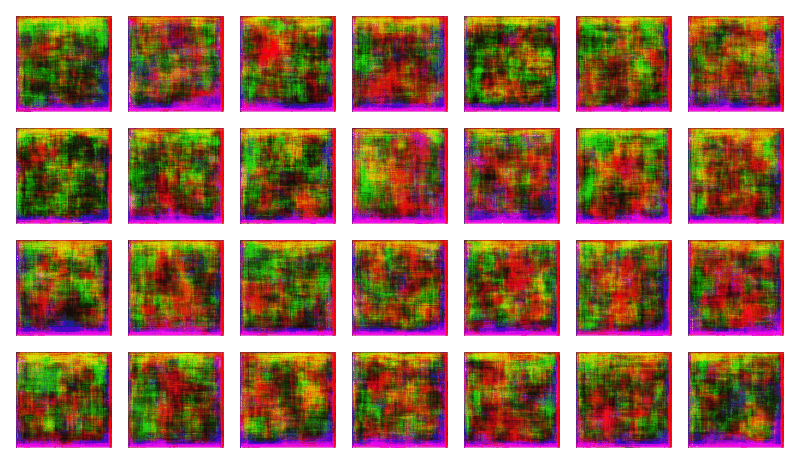

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)